# Importations :

In [1]:
import pandas as pd
import numpy as np
from binance.client import Client
import ta
import matplotlib.pyplot as plt
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Collect de données


In [2]:
def collecting_data(pair="BTCUSDT", freq=Client.KLINE_INTERVAL_1HOUR, date_init="01 September 2023"):
    
    client = Client()

    klinesT = client.get_historical_klines(pair, freq, date_init)  #  oldest dat : 2017-08-17 04:00:00

    df = pd.DataFrame(klinesT, columns = ['date', 'open', 'high', 'low', 'close', 'volume', 'close_time', 'quote_av', 'trades', 'tb_base_av', 'tb_quote_av', 'ignore' ])
    df['close'] = pd.to_numeric(df['close'])
    df['high'] = pd.to_numeric(df['high'])
    df['low'] = pd.to_numeric(df['low'])
    df['open'] = pd.to_numeric(df['open'])
    df['volume'] = pd.to_numeric(df['volume'])
    df['trades'] = pd.to_numeric(df['trades'])


    del df['ignore']
    del df['close_time']
    del df['quote_av']
    # del df['trades']
    del df['tb_base_av']
    del df['tb_quote_av']

    # Convertissez la colonne 'date' en datetime
    df['date'] = pd.to_datetime(df['date'], unit='ms')

    # Filtrez les données entre une période voulue : 
    # df = df.loc[(df['date'] >= '2022-01-01') & (df['date'] <= '2022-08-01')]

    # Définissez 'date' comme index après le filtrage
    df = df.set_index('date')

    print(df)
    return df

In [3]:

def stoch(df, periodK=14, smoothK=1, periodD=3):
    """
    Calcul de l'indicateur stochastique
    :param df: DataFrame contenant les colonnes 'high', 'low' et 'Close'
    :param periodK: Période pour %K
    :param smoothK: Lissage pour %K
    :param periodD: Période pour %D
    :return: DataFrame avec les colonnes 'K' et 'D' ajoutées
    """
    low_min = df['low'].rolling(window=periodK).min()
    high_max = df['high'].rolling(window=periodK).max()

    # Calcul de %K
    df['K'] = ((df['close'] - low_min) / (high_max - low_min)) * 100
    df['K'] = df['K'].rolling(window=smoothK).mean()

    # Calcul de %D
    df['D'] = df['K'].rolling(window=periodD).mean()

    return df

def plot_stoch(df):
    """
    Trace les graphiques pour les lignes %K et %D
    :param df: DataFrame contenant les colonnes 'K' et 'D'
    """
    plt.figure(figsize=(20, 6))
    plt.plot(df['K'], label='%K', color='#2962FF')
    plt.plot(df['D'], label='%D', color='#FF6D00')
    plt.axhline(80, color='#787B86', linestyle='--', linewidth=0.5)
    plt.axhline(50, color='#787B86', linestyle='--', linewidth=0.5, alpha=0.5)
    plt.axhline(20, color='#787B86', linestyle='--', linewidth=0.5)
    plt.fill_between(df.index, 80, 20, color='#2196F3', alpha=0.3)
    plt.title('Stochastic Oscillator')
    plt.legend()
    plt.show()


def calcRSI(data, P=14):
  # Calculate gains and losses
  data['diff_close'] = data['close'] - data['close'].shift(1)
  data['gain'] = np.where(data['diff_close']>0,
    data['diff_close'], 0)
  data['loss'] = np.where(data['diff_close']<0,
    np.abs(data['diff_close']), 0)
  
  # Get initial values
  data[['init_avg_gain', 'init_avg_loss']] = data[
    ['gain', 'loss']].rolling(P).mean()
  # Calculate smoothed avg gains and losses for all t > P
  avg_gain = np.zeros(len(data))
  avg_loss = np.zeros(len(data))
  
  for i, _row in enumerate(data.iterrows()):
    row = _row[1]
    if i < P - 1:
      last_row = row.copy()
      continue
    elif i == P-1:
      avg_gain[i] += row['init_avg_gain']
      avg_loss[i] += row['init_avg_loss']
    else:
      avg_gain[i] += ((P - 1) * avg_gain[i-1] + row['gain']) / P
      avg_loss[i] += ((P - 1) * avg_loss[i-1] + row['loss']) / P
    
    last_row = row.copy()
  
  data['avg_gain'] = avg_gain
  data['avg_loss'] = avg_loss
  # Calculate RS and RSI
  data['RS'] = data['avg_gain'] / data['avg_loss']
  data['RSI'] = 100 - 100 / (1 + data['RS'])
  return data['RSI']

def stoch_rsi(df, lengthRSI=14, lengthStoch=14, smoothK=3, smoothD=3):
    """
    Calcul du Stochastic RSI
    :param df: DataFrame contenant les prix
    :param lengthRSI: Période pour le RSI
    :param lengthStoch: Période pour le Stochastic
    :param smoothK: Lissage pour %K
    :param smoothD: Lissage pour %D
    :return: DataFrame avec les colonnes 'K' et 'D' du Stochastic RSI
    """
    df['RSI'] = calcRSI(df, lengthRSI)
    min_rsi = df['RSI'].rolling(window=lengthStoch).min()
    max_rsi = df['RSI'].rolling(window=lengthStoch).max()

    df['K_RSI'] = 100 * ((df['RSI'] - min_rsi) / (max_rsi - min_rsi))
    df['K_RSI'] = df['K_RSI'].rolling(window=smoothK).mean()
    df['D_RSI'] = df['K_RSI'].rolling(window=smoothD).mean()

    return df

def plot_stoch_rsi(df):
    """
    Trace les graphiques pour les lignes %K et %D du Stochastic RSI
    :param df: DataFrame contenant les colonnes 'K' et 'D'
    """
    plt.figure(figsize=(20, 6))
    plt.plot(df['K_RSI'], label='K_RSI', color='#2962FF')
    plt.plot(df['D_RSI'], label='D_RSI', color='#FF6D00')
    plt.axhline(80, color='#787B86', linestyle='--', linewidth=0.5)
    plt.axhline(50, color='#787B86', linestyle='--', linewidth=0.5, alpha=0.5)
    plt.axhline(20, color='#787B86', linestyle='--', linewidth=0.5)
    plt.fill_between(df.index, 80, 20, color='#2196F3', alpha=0.3)
    plt.title('Stochastic RSI')
    plt.legend()
    plt.show()

## Frais = Prix d’ouverture/de clôture × Montant × (Frais de Taker ou de Maker)

## Prix initial = 23 715,50 USDT

## Montant = 0,0041 SBTC

## Frais de Taker = 0,06 % = (0,06/100)

## Application de la formule : 23 715,50 USDT × 0.0041 SBTC × (0,06/100) = 0,05834 USDT

source : https://www.bitget.com/fr/academy/Futures-Fees-Calculation-in-Detail

We begin by the constructing a dataset that contains the predictors which will be used to make the predictions, and the output variable.

The current Data of the bicoin consists of date, open, high, low, close and Volume. Using this data we calculate the following  technical indicators:
* **Moving Average** : A moving average provides an indication of the trend of the price movement by cut down the amount of "noise" on a price chart.
* **Stochastic Oscillator %K and %D** : A stochastic oscillator is a momentum indicator comparing a particular closing price of a security to a range of its prices over a certain period of time. %K and %D are slow and fast indicators.
* **Relative Strength Index(RSI)** :It is a momentum indicator that measures the magnitude of recent price changes to evaluate overbought or oversold conditions in the price of a stock or other asset.
* **Rate Of Change(ROC)**: It is a momentum oscillator, which measures the percentage change between the current price and the n period past price.
* **Momentum (MOM)** : It is the rate of acceleration of a security's price or volume – that is, the speed at which the price is changing.

In [66]:
class BacktestingModel:
    def __init__(self) -> None:
        self.df = pd.DataFrame()
        self.trades = []    # pour assurer le suivi de notre portefeuille. 
        self.days = []      # Pour assurer le suivi de la période de chaque trade.
        self.df_days = pd.DataFrame() # DF contenant la période de trading backtested.
        self.df_trades = pd.DataFrame()  # DF qui va contenir toutes nos trades.


    def load_data(self, df):
        self.df = df



    def load_indicators(self): # indicator will be loaded to df directly
        _ = stoch_rsi(self.df, lengthRSI=14, lengthStoch=14, smoothK=3, smoothD=3)
        _ = stoch(self.df,periodK=14, smoothK=1, periodD=3)
        print("Paramètres :\n"+ 
            "Stock_RSI : lengthRSI=14, lengthStoch=14, smoothK=3, smoothD=3"+'\n'+
            "Stoch : periodK=14, smoothK=1, periodD=3 \n")


    def populate_signals(self): # Strategy Stoch - StochRSI
        self.load_indicators()
        self.df["buy_signal"] = False
        self.df["sell_signal"] = False
        self.df.loc[(self.df[f"K"] > self.df[f"D"]) & (self.df[f"K_RSI"] > self.df[f"D_RSI"]) , "buy_signal"] = True
        self.df.loc[(self.df[f"K"] < self.df[f"D"]) & (self.df[f"K_RSI"] < self.df[f"D_RSI"]), "sell_signal"] = True

    # -- Condition to open Market LONG --
    def openLongCondition(self,row):
        if (row[f"K"] > row[f"D"]  
        and row[f"K_RSI"] > row[f"D_RSI"]
        ):
            return True
        else:
            return False

    # -- Condition to close Market LONG --
    def closeLongCondition(self,row):
        if (row[f"K"] <= row[f"D"]  
        and row[f"K_RSI"] <= row[f"D_RSI"]):
            return True
        else:
            return False
    # -- Condition to open Market SHORT --    # A valider !!! 
    def openShortCondition(self, row):
        if (row[f"K"] < row[f"D"]  
        and row[f"K_RSI"] < row[f"D_RSI"]
         ):
            return True
        else:
            return False

    # -- Condition to close Market SHORT --
    def closeShortCondition(self, row):
        if (row[f"K"] >= row[f"D"]  
        and row[f"K_RSI"] >= row[f"D_RSI"]):
            return True
        else:
            return False
        
    def run_backtest(self, wallet,leverage, coef_stoploss ,coef_takeprofit):
            # -- You can change variables below --
            self.leverage = leverage
            # -- Do not touch these values --
            initalWallet = wallet
            lastAth = wallet
            position = None
            makerFee = 0.0002 # pour des ordres qui sont programmées dans le carnet d'ordre.
            takerFee = 0.001 # sur des ordres qui sont liquidés/executés directement.
            self.coef_stoploss = coef_stoploss # stop loss 20 % of open price 
            self.coef_takeprofit = coef_takeprofit
            self.trades = []
            self.days = []

            position = None
            orderInProgress = ''

            for index, row in self.df.iterrows():

                # -- If there is NO order in progress --
                if orderInProgress == '' and position == None:
                    # Update of wallet position : 
                    self.days.append({
                        "day": index,
                        "balance": wallet,
                        "close_price": row['close'],
                        "prc_evolution_tokens": 0
                    })
                    # -- Check If you have to open a LONG --
                    if self.openLongCondition(row) == True:

                        orderInProgress = 'LONG'
                        closePrice = row['close']
                        tokenAmount = (wallet * leverage) / row['close']
                        # fee = tokenAmount * closePrice * takerFee
                        fee = 0
                        # longLiquidationPrice = longIniPrice - (wallet/tokenAmount) # Est ce qu'on a besoin de ca ?
                        stop_loss = wallet - (wallet * self.coef_stoploss * leverage)
                        montantwallet_risked = (wallet * self.coef_stoploss * leverage)
                        takeProfit = wallet + (wallet * self.coef_takeprofit * leverage)
                        montantpossibly_gained = (wallet * self.coef_takeprofit * leverage)
                        # -- You can uncomment the line below if you want to see logs --
                        # print('Open LONG at', closePrice, '$ the', index, '| Liquidation price :', longLiquidationPrice)


                        # Enregistre le trade dans le df.trades : 
                        # -- Add the trade to DT to analyse it later -- # Question : Drawback signification ?
                        position = {'open_date': index, 
                                    'position': "Open Long",
                                    'reason': 'Open Long Market',
                                    'price': closePrice,
                                    'frais': fee,
                                    "open_size" : tokenAmount,
                                    'wallet': wallet,
                                    "stop_loss": stop_loss,
                                    "take_profit": takeProfit,
                                    'drawBack': (wallet-lastAth)/lastAth,
                                    "montantwallet_risked" : montantwallet_risked,
                                    "montantpossibly_gained" : montantpossibly_gained,}

                    # -- Check If you have to open a SHORT --
                    elif self.openShortCondition(row) == True:

                        orderInProgress = 'SHORT'
                        closePrice = row['close']
                        tokenAmount = (wallet * leverage) / row['close']
                        # fee = tokenAmount * closePrice * takerFee
                        fee = 0
                        # shortLiquidationPrice = closePrice + (wallet/tokenAmount)
                        stop_loss = wallet + (wallet * self.coef_stoploss * leverage)
                        montantwallet_risked = (wallet * self.coef_stoploss * leverage)
                        takeProfit = wallet - (wallet * self.coef_takeprofit * leverage)
                        montantpossibly_gained = (wallet * self.coef_takeprofit * leverage)
                        # -- You can uncomment the line below if you want to see logs --
                        # print('Open SHORT', closePrice, '$ the', index, '| Liquidation price :', shortLiquidationPrice)

                        # Enregistre le trade dans le df.trades :
                        # -- Add the trade to DT to analyse it later --
                        position = {'open_date': index, 
                                'position': "Open Short", 
                                'reason': 'Open Short Market', 
                                'price': closePrice,
                                'frais': fee,
                                "open_size" : tokenAmount,
                                'wallet': wallet, 
                                "stop_loss": stop_loss,
                                "take_profit": takeProfit,
                                'drawBack': (wallet-lastAth)/lastAth,
                                "montantwallet_risked" : montantwallet_risked,
                                "montantpossibly_gained" : montantpossibly_gained,
                                }
                        
                    

                # -- If there is an order in progress --
                elif orderInProgress != "" and position: 
                    # Update of wallet position : 
                    close_price = row["close"]
                    trade_resultprc = (close_price - position["price"]) / position["price"] 
                    temp_balance = position['wallet'] + trade_resultprc * position['wallet'] * leverage
                    self.days.append({
                        "day": index,
                        "balance": temp_balance,
                        "close_price": row['close'],
                        "prc_evolution_tokens": trade_resultprc,
                    })

                    # -- Check if there is a LONG order in progress --
                    if orderInProgress == "LONG" and position['position'] == "Open Long" :
                        # -- Check Liquidation --

                        # -- Check If you have to close the LONG --
                        if self.closeLongCondition(row) == True :
                            orderInProgress = ''
                            pr_change = (row['close'] - position['price']) / position['price']
                            wallet = wallet + wallet*pr_change*leverage
                            # fee = position['open_size'] * closePrice * takerFee
                            fee = 0
                            # -- You can uncomment the line below if you want to see logs --
                            # print('Close LONG at',closePrice,"the", index, '| wallet :', wallet,
                            #       '| result :', pr_change*100*leverage)

                            # -- Check if your wallet hit a new ATH to know the drawBack --
                            if wallet > lastAth:
                                lastAth = wallet

                            # -- Add the trade to DT to analyse it later --
                            self.trades.append({
                                "open_date" : position["open_date"],
                                "close_date" : index,
                                "open_price" : position["price"],
                                "close_price" : closePrice,
                                "fee_open" : position['frais'],
                                "fee_close" : fee,
                                "open_balance" : position["wallet"],
                                "close_balance" : wallet,
                                "open_reason" : position["reason"],
                                "close_reason" : "close_long",
                                "trade_result" : wallet*pr_change*leverage,
                                "trade_result_pct" : pr_change,
                                "profittrade_withfees" : wallet - fee - position['frais'],
                                "take_profit" : position["take_profit"],
                                "stop_loss_amount" : position["stop_loss"],
                                "montantwallet_risked" : position['montantwallet_risked'],
                                "montantpossibly_gained" : position['montantpossibly_gained'],
                                "R_multiplier" : (position['montantpossibly_gained']/position['montantwallet_risked']),
                                "drawBack" : position['drawBack'],

                            })
                            position = None

                        # -- Stoploss Alerte : Check If you have to close the LONG  --
                        elif temp_balance <= position['stop_loss']  :
                            orderInProgress = ''
                            pr_change = (row['close'] - position['price']) / position['price']
                            wallet = wallet + wallet*pr_change*leverage
                            fee = position['open_size'] * closePrice * takerFee
                            fee = 0
                            # -- You can uncomment the line below if you want to see logs --
                            # print('Close LONG at',closePrice,"the", index, '| wallet :', wallet,
                            #       '| result :', pr_change*100*leverage)

                            # -- Check if your wallet hit a new ATH to know the drawBack --
                            if wallet > lastAth:
                                lastAth = wallet

                            # -- Add the trade to DT to analyse it later --
                            self.trades.append({
                                "open_date" : position["open_date"],
                                "close_date" : index,
                                "open_price" : position["price"],
                                "close_price" : closePrice,
                                "fee_open" : position['frais'],
                                "fee_close" : fee,
                                "open_balance" : position["wallet"],
                                "close_balance" : wallet,
                                "open_reason" : position["reason"],
                                "close_reason" : "stoploss_long",
                                "trade_result" : wallet*pr_change*leverage,
                                "trade_result_pct" : pr_change,
                                "profittrade_withfees" : wallet - fee - position['frais'],
                                "take_profit" : position["take_profit"],
                                "stop_loss_amount" : position["stop_loss"],
                                "montantwallet_risked" : position['montantwallet_risked'],
                                "montantpossibly_gained" : position['montantpossibly_gained'],
                                "R_multiplier" : (position['montantpossibly_gained']/position['montantwallet_risked']),
                                "drawBack" : position['drawBack'],

                            })
                            position = None

                        # -- Take_profit Alerte : Check If you have to close the LONG  --
                        elif temp_balance >= position['take_profit'] :
                            orderInProgress = ''
                            pr_change = (row['close'] - position['price']) / position['price']
                            wallet = wallet + wallet*pr_change*leverage
                            fee = position['open_size'] * closePrice * takerFee
                            fee = 0
                            # -- You can uncomment the line below if you want to see logs --
                            # print('Close LONG at',closePrice,"the", index, '| wallet :', wallet,
                            #       '| result :', pr_change*100*leverage)

                            # -- Check if your wallet hit a new ATH to know the drawBack --
                            if wallet > lastAth:
                                lastAth = wallet

                            # -- Add the trade to DT to analyse it later --
                            self.trades.append({
                                "open_date" : position["open_date"],
                                "close_date" : index,
                                "open_price" : position["price"],
                                "close_price" : closePrice,
                                "fee_open" : position['frais'],
                                "fee_close" : fee,
                                "open_balance" : position["wallet"],
                                "close_balance" : wallet,
                                "open_reason" : position["reason"],
                                "close_reason" : "takeprofit_long",
                                "trade_result" : wallet*pr_change*leverage,
                                "trade_result_pct" : pr_change,
                                "profittrade_withfees" : wallet - fee - position['frais'],
                                "take_profit" : position["take_profit"],
                                "stop_loss_amount" : position["stop_loss"],
                                "montantwallet_risked" : position['montantwallet_risked'],
                                "montantpossibly_gained" : position['montantpossibly_gained'],
                                "R_multiplier" : (position['montantpossibly_gained']/position['montantwallet_risked']),
                                "drawBack" : position['drawBack'],

                            })
                            position = None

                    elif orderInProgress == "SHORT" and position['position'] == "Open Short":

                        # -- Check Liquidation --


                        # -- Check If you have to close the SHORT --
                        if self.closeShortCondition(row) == True :
                            orderInProgress = ''
                            pr_change = -(row['close'] - position['price']) / position['price']
                            wallet = wallet + wallet*pr_change*leverage
                            fee = position['open_size'] * closePrice * takerFee
                            fee = 0
                            # -- You can uncomment the line below if you want to see logs --
                            # print('Close SHORT at',closePrice,"the", index, '| wallet :', wallet,
                            #       '| result :', pr_change*100*leverage)

                            # -- Check if your wallet hit a new ATH to know the drawBack --
                            if wallet > lastAth:
                                lastAth = wallet

                            # -- Add the trade to DT to analyse it later --
                            self.trades.append({
                                "open_date" : position["open_date"],
                                "close_date" : index,
                                "open_price" : position["price"],
                                "close_price" : row['close'],
                                "fee_open" : position['frais'],
                                "fee_close" : fee,
                                "open_balance" : position["wallet"],
                                "close_balance" : wallet,
                                "open_reason" : position["reason"],
                                "close_reason" : "close_Short",
                                "trade_result" : wallet*pr_change*leverage,
                                "trade_result_pct" : pr_change,
                                "profittrade_withfees" : wallet - fee - position['frais'],
                                "take_profit" : position["take_profit"],
                                "stop_loss_amount" : position["stop_loss"],
                                "montantwallet_risked" : position['montantwallet_risked'],
                                "montantpossibly_gained" : position['montantpossibly_gained'],
                                "R_multiplier" : (position['montantpossibly_gained']/position['montantwallet_risked']),
                                "drawBack" : position['drawBack'],

                            })
                            position = None
                        # -- Stoploss Alerte : Check If you have to close the SHORT  --
                        elif temp_balance >= position['stop_loss']:
                            orderInProgress = ''
                            pr_change = -(row['close'] - position['price']) / position['price']
                            wallet = wallet + wallet*pr_change*leverage
                            fee = position['open_size'] * closePrice * takerFee
                            fee = 0
                            # -- You can uncomment the line below if you want to see logs --
                            # print('Close SHORT at',closePrice,"the", index, '| wallet :', wallet,
                            #       '| result :', pr_change*100*leverage)

                            # -- Check if your wallet hit a new ATH to know the drawBack --
                            if wallet > lastAth:
                                lastAth = wallet

                            # -- Add the trade to DT to analyse it later --
                            self.trades.append({
                                "open_date" : position["open_date"],
                                "close_date" : index,
                                "open_price" : position["price"],
                                "close_price" : row['close'],
                                "fee_open" : position['frais'],
                                "fee_close" : fee,
                                "open_balance" : position["wallet"],
                                "close_balance" : wallet,
                                "open_reason" : position["reason"],
                                "close_reason" : "stoploss_Short",
                                "trade_result" : wallet*pr_change*leverage,
                                "trade_result_pct" : pr_change,
                                "profittrade_withfees" : wallet - fee - position['frais'],
                                "take_profit" : position["take_profit"],
                                "stop_loss_amount" : position["stop_loss"],
                                "montantwallet_risked" : position['montantwallet_risked'],
                                "montantpossibly_gained" : position['montantpossibly_gained'],
                                "R_multiplier" : (position['montantpossibly_gained']/position['montantwallet_risked']),
                                "drawBack" : position['drawBack'],

                            })
                            position = None


                        # -- Takeprofit Alerte : Check If you have to close the SHORT  --
                        elif temp_balance <= position['take_profit']:
                            orderInProgress = ''
                            pr_change = -(row['close'] - position['price']) / position['price']
                            fee = position['open_size'] * closePrice * takerFee
                            fee = 0
                            wallet = wallet + wallet*pr_change*leverage
                            # -- You can uncomment the line below if you want to see logs --
                            # print('Close SHORT at',closePrice,"the", index, '| wallet :', wallet,
                            #       '| result :', pr_change*100*leverage)

                            # -- Check if your wallet hit a new ATH to know the drawBack --
                            if wallet > lastAth:
                                lastAth = wallet

                            # -- Add the trade to DT to analyse it later --
                            self.trades.append({
                                "open_date" : position["open_date"],
                                "close_date" : index,
                                "open_price" : position["price"],
                                "close_price" : row['close'],
                                "fee_open" : position['frais'],
                                "fee_close" : fee,
                                "open_balance" : position["wallet"],
                                "close_balance" : wallet,
                                "open_reason" : position["reason"],
                                "close_reason" : "takeprofit_Short",
                                "trade_result" : wallet*pr_change*leverage,
                                "trade_result_pct" : pr_change,
                                "profittrade_withfees" : wallet - fee - position['frais'],
                                "take_profit" : position["take_profit"],
                                "stop_loss_amount" : position["stop_loss"],
                                "montantwallet_risked" : position['montantwallet_risked'],
                                "montantpossibly_gained" : position['montantpossibly_gained'],
                                "R_multiplier" : (position['montantpossibly_gained']/position['montantwallet_risked']),
                                "drawBack" : position['drawBack'],

                            })
                            position = None

    def backtest_analysis(self):
        df_trades = pd.DataFrame(self.trades)
        df_days = pd.DataFrame(self.days)
        
        if df_trades.empty:
            raise Exception("No trades found")
        if df_days.empty:
            raise Exception("No days found")

        df_days['evolution'] = df_days['balance'].diff()
        df_days['daily_return'] = df_days['evolution']/df_days['balance'].shift(1)

        df_trades["trades_duration"] = df_trades["close_date"] - df_trades["open_date"]

        # Another way to calculate drawback and compare it with the values in df.trades
        df_days["balance_ath"] = df_days["balance"].cummax()
        df_days["drawBack"] = df_days["balance_ath"] - df_days["balance"]
        df_days["drawBack_pct"] = df_days["drawBack"] / df_days["balance_ath"]

        total_trades = len(df_trades)
        total_days = len(df_days)

        good_trades = df_trades.loc[df_trades["trade_result"] > 0]
        total_good_trades = len(good_trades)
        avg_profit_good_trades = good_trades["trade_result_pct"].mean()
        mean_good_trades_duration = good_trades["trades_duration"].mean()
        global_win_rate = total_good_trades / total_trades

        bad_trades = df_trades.loc[df_trades["trade_result"] < 0]
        total_bad_trades = len(bad_trades)
        avg_profit_bad_trades = bad_trades["trade_result_pct"].mean()
        mean_bad_trades_duration = bad_trades["trades_duration"].mean()

        max_days_drawdown = df_days["drawBack_pct"].max()
        initial_balance = df_days.iloc[0]["balance"]
        final_balance = df_trades.iloc[-1]['profittrade_withfees']
        balance_evolution = (final_balance - initial_balance) / initial_balance
        mean_trades_duration = df_trades["trades_duration"].mean()
        avg_profit = df_trades["trade_result_pct"].mean()
        mean_trades_duration = df_trades['trades_duration'].mean()
        mean_trades_per_days = total_trades/total_days

        best_trade = df_trades.loc[df_trades["trade_result_pct"].idxmax()]
        worst_trade = df_trades.loc[df_trades["trade_result_pct"].idxmin()]

        sharpe_ratio = (365**(0.5) * df_days['daily_return'].mean())/df_days['daily_return'].std()


        # KPIS : # Marwane


        # Définir la largeur de la colonne pour l'alignement
        column_width = 57

        # Créer des blocs de texte pour chaque section
        general_info = (
            f"--- General Information ---\n"
            f"Period: [{df_days.iloc[0]['day']}] -> [{df_days.iloc[-1]['day']}] \n"
            f"Leverage: {self.leverage} \n"
            f"Initial balance: {round(initial_balance,2)} $ \n"
            f"Final balance: {round(final_balance,2)} $\n"
            f"Sharpe Ratio: {round(sharpe_ratio,2)}\n"
            f"Performance: {round(balance_evolution*100,2)} %\n"
            f"Profit $$: {round(final_balance - initial_balance,2)} $ \n"
            f"Worst Drawdown: -{round(max_days_drawdown*100, 2)}%\n"
            f"Stoploss set to: {self.coef_stoploss*100} %  | initialement : {initial_balance* self.coef_stoploss * self.leverage} $\n"
            f"Takeprofit set to: {self.coef_takeprofit*100} %  | initialement : {initial_balance* self.coef_takeprofit * self.leverage} $\n"
            f"Total trades: {total_trades}\n"
            f"Average Profit: {round(avg_profit*100, 2)} %\n"
            f"Global Win rate: {round(global_win_rate*100, 2)} %\n"
        )

        trades_info = (
            f"--- Trades Information ---\n"
            f"Mean Trades/day: {round(mean_trades_per_days, 2)}\n"
            f"Mean Trade Duration: {mean_trades_duration}\n"
            f"Best trade: +{round(best_trade['trade_result_pct']*100, 2)} %\n"
            f"Worst trade: {round(worst_trade['trade_result_pct']*100, 2)} %\n"
            f"Good trades: {total_good_trades}\n"
            f"Bad trades: {total_bad_trades}\n"
            f"Ratio G/totale trades: {round(total_good_trades/total_trades*100)}%\n"
            f"Good Trade Avg: {round(avg_profit_good_trades*100, 2)} %\n"
            f"Bad Trade Avg: {round(avg_profit_bad_trades*100, 2)} %\n"
            f"Mean Good Trades Duration: {mean_good_trades_duration} \n"
            f"Mean Bad Trades Duration: {mean_bad_trades_duration} \n"

        )

        trades_reasons = (
            f"--- Trades reasons ---\n"
            f"\n{df_trades['open_reason'].value_counts().to_string()}\n"
            f"\n{df_trades['close_reason'].value_counts().to_string()}\n"
        )

        # Calculer l'espace nécessaire pour aligner les blocs horizontalement
        max_length = max(len(general_info), len(trades_info), len(trades_reasons))
        general_info += '\n' * (max_length - len(general_info.split('\n')))
        trades_info += '\n' * (max_length - len(trades_info.split('\n')))
        trades_reasons += '\n' * (max_length - len(trades_reasons.split('\n')))

        # Fusionner les blocs avec un espace entre eux
        combined_info = ''.join(f"{g.ljust(column_width)}{t.ljust(column_width)}{r}\n"
                                for g, t, r in zip(general_info.split('\n'), trades_info.split('\n'), trades_reasons.split('\n')))

        print(combined_info)

        self.df_days = df_days
        self.df_trades = df_trades

    def plot_equity_vs_asset(self):
        df_days = self.df_days.copy()

        # Configuration des couleurs et du style
        background_color = 'rgba(50, 50, 50, 1)'  # Gris foncé
        text_color = 'white'
        curve_colors = ['rgba(65, 105, 225, 0.8)', 'rgba(244, 164, 96, 0.8)', 'rgba(205, 92, 92, 0.8)','rgba(20, 92, 92, 0.8)','rgba(205, 9, 92, 0.8)']

        # Définir la taille de la figure et l'espacement entre les subplots
        fig_height = 600  # Hauteur de la figure en pixels

        # Figure 1: Profit and Lose curve
        fig1 = go.Figure()
        fig1.add_trace(go.Scatter(x=df_days.day, y=df_days['balance'], fill='tozeroy', name='Balance evolution', line=dict(color=curve_colors[0])))
        fig1.update_layout(title='Profit and Lose curve', plot_bgcolor=background_color, paper_bgcolor=background_color, font=dict(color=text_color), height=fig_height,)
        fig1.show()

        # Figure 2: Asset evolution
        fig2 = go.Figure()
        fig2.add_trace(go.Scatter(x=df_days.day, y=df_days['close_price'], fill='tozeroy', name='Asset evolution', line=dict(color=curve_colors[1])))
        fig2.update_layout(title='Asset evolution', plot_bgcolor=background_color, paper_bgcolor=background_color, font=dict(color=text_color), height=fig_height,)
        fig2.show()

        # Figure 3: Drawdown curve
        fig3 = go.Figure()
        fig3.add_trace(go.Scatter(x=df_days.day, y=-df_days['drawBack_pct']*100, fill='tozeroy', name='Drawdown in %', line=dict(color=curve_colors[2])))
        fig3.update_layout(title='Drawdown curve', plot_bgcolor=background_color, paper_bgcolor=background_color, font=dict(color=text_color), height=fig_height)
        fig3.show()

        # Figure 4: P&L VS Asset (not on the same scale)
        fig4 = go.Figure()
        fig4.add_trace(go.Scatter(x=df_days.day, y=df_days['balance'], name='Wallet evolution (equity)', line=dict(color=curve_colors[0])))
        fig4.add_trace(go.Scatter(x=df_days.day, y=self.df['close'], name='Asset evolution', line=dict(color=curve_colors[1]), yaxis='y2'))
        fig4.add_trace(go.Scatter(x=df_days.day, y=self.df['volume'], name='Volume evolution', line=dict(color=curve_colors[2]), yaxis='y2'))
        fig4.add_trace(go.Scatter(x=df_days.day, y=self.df['trades'], name='Trades evolution', line=dict(color=curve_colors[4]), yaxis='y2'))
        fig4.update_layout(title='P&L VS Asset', plot_bgcolor=background_color, paper_bgcolor=background_color, font=dict(color=text_color), height=fig_height)
        fig4.update_layout(yaxis2=dict(overlaying='y', side='right'))
        fig4.show()

    

    

# Backtesting : 

In [71]:
data = collecting_data(pair="BTCUSDT", freq=Client.KLINE_INTERVAL_1DAY, date_init="01 september 2023")

                open      high       low     close       volume   trades
date                                                                    
2023-09-01  25940.77  26156.00  25333.75  25805.05  41032.15056   881179
2023-09-02  25805.04  25987.50  25752.47  25869.51  16250.77698   567728
2023-09-03  25869.52  26135.00  25800.00  25971.21  17474.47667   496412
2023-09-04  25971.21  26108.02  25631.21  25826.02  21777.59609   596830
2023-09-05  25826.03  25915.49  25562.62  25792.10  21323.39337   566736
...              ...       ...       ...       ...          ...      ...
2023-12-11  43789.50  43804.50  40222.00  41253.40  76663.89804  2087142
2023-12-12  41253.41  42104.12  40680.00  41492.39  42722.69773  1526411
2023-12-13  41492.38  43475.20  40555.00  42869.03  45865.99773  1724659
2023-12-14  42869.03  43420.00  41400.00  43022.26  42047.05709  1599536
2023-12-15  43022.26  43080.81  42200.00  42288.01  18273.37329   765332

[106 rows x 6 columns]


In [85]:
# Stock StochRSI : 
bt = BacktestingModel()
bt.load_data(data.copy())
bt.populate_signals()
bt.run_backtest(wallet = 1000,leverage = 1, coef_stoploss = 1 ,coef_takeprofit = 1)
bt.backtest_analysis()
bt.plot_equity_vs_asset()

Paramètres :
Stock_RSI : lengthRSI=14, lengthStoch=14, smoothK=3, smoothD=3
Stoch : periodK=14, smoothK=1, periodD=3 

--- General Information ---                              --- Trades Information ---                               --- Trades reasons ---
Period: [2023-09-01 00:00:00] -> [2023-12-15 00:00:00]   Mean Trades/day: 0.09                                    
Leverage: 1                                              Mean Trade Duration: 6 days 07:12:00                     open_reason
Initial balance: 1000.0 $                                Best trade: +21.79 %                                     Open Long Market     5
Final balance: 1361.32 $                                 Worst trade: -3.72 %                                     Open Short Market    5
Sharpe Ratio: 2.77                                       Good trades: 5                                           
Performance: 36.13 %                                     Bad trades: 5                                            

In [86]:
bt.df_days

,day,balance,close_price,prc_evolution_tokens,evolution,daily_return,balance_ath,drawBack,drawBack_pct
0,2023-09-01,1000.000000,25805.05,0.000000,NaN,NaN,1000.0000,0.000000,0.000000
1,2023-09-02,1000.000000,25869.51,0.000000,0.000000,0.000000,1000.0000,0.000000,0.000000
2,2023-09-03,1000.000000,25971.21,0.000000,0.000000,0.000000,1000.0000,0.000000,0.000000
3,2023-09-04,1000.000000,25826.02,0.000000,0.000000,0.000000,1000.0000,0.000000,0.000000
4,2023-09-05,1000.000000,25792.10,0.000000,0.000000,0.000000,1000.0000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...
101,2023-12-11,1290.304863,41253.40,-0.046674,-79.323282,-0.057916,1381.5599,91.255038,0.066052
102,2023-12-12,1297.779882,41492.39,-0.041151,7.475019,0.005793,1381.5599,83.780018,0.060642
103,2023-12-13,1340.837795,42869.03,-0.009339,43.057912,0.033178,1381.5599,40.722106,0.029475
104,2023-12-14,1345.630452,43022.26,-0.005798,4.792657,0.003574,1381.5599,35.929448,0.026006


<Axes: >

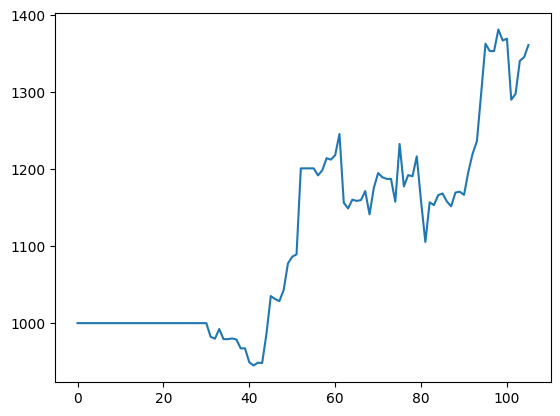

In [87]:
bt.df_days['balance'].plot()

<Axes: >

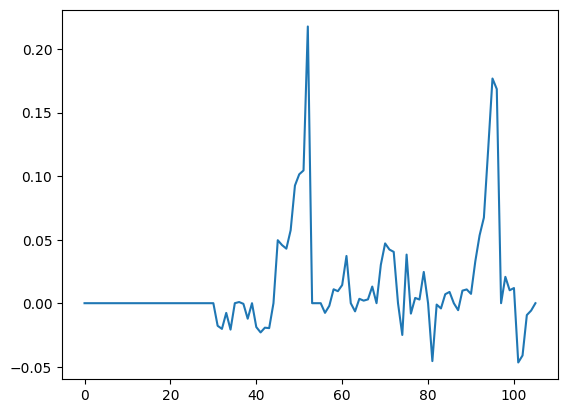

In [88]:
(bt.df_days['prc_evolution_tokens']).plot()

In [89]:
bt.df_trades

,open_date,close_date,open_price,close_price,fee_open,fee_close,open_balance,close_balance,open_reason,close_reason,trade_result,trade_result_pct,profittrade_withfees,take_profit,stop_loss_amount,montantwallet_risked,montantpossibly_gained,R_multiplier,drawBack,trades_duration
0,2023-10-01,2023-10-05,27992.57,27992.57,0,0,1000.000000,979.202338,Open Long Market,close_long,-20.365119,-0.020798,979.202338,2000.000000,0.000000,1000.000000,1000.000000,1.0,0.000000,4 days
1,2023-10-06,2023-10-09,27931.09,27931.09,0,0,979.202338,967.248683,Open Long Market,close_long,-11.807731,-0.012208,967.248683,1958.404677,0.000000,979.202338,979.202338,1.0,-0.020798,3 days
2,2023-10-10,2023-10-14,27390.12,26852.48,0,0,967.248683,986.234784,Open Short Market,close_Short,19.358779,0.019629,986.234784,0.000000,1934.497366,967.248683,967.248683,1.0,-0.032751,4 days
3,2023-10-15,2023-10-23,27154.15,27154.15,0,0,986.234784,1201.097234,Open Long Market,close_long,261.672675,0.217861,1201.097234,1972.469568,0.000000,986.234784,986.234784,1.0,-0.013765,8 days
4,2023-10-26,2023-11-01,34151.66,35421.43,0,0,1201.097234,1156.440042,Open Short Market,close_Short,-42.996823,-0.037180,1156.440042,0.000000,2402.194467,1201.097234,1201.097234,1.0,0.000000,6 days
5,2023-11-02,2023-11-07,34941.59,35399.12,0,0,1156.440042,1141.297456,Open Short Market,close_Short,-14.944306,-0.013094,1141.297456,0.000000,2312.880083,1156.440042,1156.440042,1.0,-0.037180,5 days
6,2023-11-08,2023-11-12,35624.72,35624.72,0,0,1141.297456,1187.411362,Open Long Market,close_long,47.977129,0.040405,1187.411362,2282.594912,0.000000,1141.297456,1141.297456,1.0,-0.049788,4 days
7,2023-11-13,2023-11-19,36462.93,37359.86,0,0,1187.411362,1158.202933,Open Short Market,close_Short,-28.489947,-0.024598,1158.202933,0.000000,2374.822723,1187.411362,1187.411362,1.0,-0.011394,6 days
8,2023-11-20,2023-12-06,37448.78,37448.78,0,0,1158.202933,1353.477361,Open Long Market,close_long,228.197935,0.168601,1353.477361,2316.405867,0.000000,1158.202933,1158.202933,1.0,-0.035713,16 days
9,2023-12-07,2023-12-14,43273.14,43022.26,0,0,1353.477361,1361.324270,Open Short Market,close_Short,7.892402,0.005798,1361.324270,0.000000,2706.954722,1353.477361,1353.477361,1.0,0.000000,7 days


In [90]:
# Création de la figure
fig = go.Figure()

# Ajout des lignes à la figure
fig.add_trace(go.Scatter(x=bt.df_trades.index, y=bt.df_trades['montantwallet_risked'], mode='lines', name='Montant Wallet Risked'))
fig.add_trace(go.Scatter(x=bt.df_trades.index, y=bt.df_trades['montantpossibly_gained'], mode='lines', name='Montant Possibly Gained'))
fig.add_trace(go.Scatter(x=bt.df_trades.index, y=bt.df_trades['close_balance'], mode='lines', name='Close Balance'))

# Mise en forme du titre et des axes
fig.update_layout(
    title="Évolution des données Risk et Gain",
    xaxis_title="Date",
    yaxis_title="Valeurs",
    showlegend=True,
    plot_bgcolor='black',     # Fond du graphique
    paper_bgcolor='black',    # Fond de la zone extérieure du graphique
    font=dict(color='white'), # Couleur du texte
    xaxis=dict(color='white', showline=True, linewidth=1, linecolor='white'), # Axes X
    yaxis=dict(color='white', showline=True, linewidth=1, linecolor='white'),  # Axes Y
)


# Affichage de la figure
fig.show()


In [91]:
import plotly.graph_objs as go

# Filtrer les données selon les conditions
filtered_data = bt.df_trades.loc[
    (bt.df_trades['close_reason'] == 'stoploss_Short') &
    (bt.df_trades['close_price'] > bt.df_trades['open_price'])
].set_index(['close_date'])

# Créer un graphique à partir des données filtrées
fig = go.Figure()

# Ajouter une trace pour le graphique (Trade Result)
fig.add_trace(
    go.Scatter(
        x=filtered_data.index,
        y=filtered_data['trade_result'],
        mode='lines',
        name='Trade Result',
        yaxis='y',  # Associer cette trace à l'axe y existant
    )
)

# Ajouter une trace pour le graphique (Montantwallet Risked)
fig.add_trace(
    go.Scatter(
        x=filtered_data.index,
        y=-filtered_data['montantwallet_risked'],
        mode='lines',
        name='Montantwallet Risked',
        yaxis='y',  # Associer cette trace à l'axe y existant
    )
)

# Créer un deuxième axe Y pour les barres
fig.update_layout(
    yaxis2=dict(
        title='Trade Result Percentage',  # Titre pour le deuxième axe Y
        overlaying='y',  # Superposer le deuxième axe Y au premier
        side='right',    # Position du deuxième axe Y
        showgrid=False   # Masquer la grille pour le deuxième axe Y
    )
)

# Ajouter une trace pour le graphique en barres avec le deuxième axe Y
fig.add_trace(
    go.Bar(
        x=filtered_data.index,
        y=filtered_data['trade_result_pct'],
        name='Trade Result Percentage',
        yaxis='y2',  # Associer cette trace au deuxième axe Y
        marker=dict(
            color='rgba(255, 0, 0, 0.5)',  # Couleur des barres (rouge avec 50% de transparence)
            line=dict(color='green', width=2),  # Bordure des barres
            opacity=0.7  # Transparence des barres (50%)
        ),
        width=0.6,  # Ajuster la largeur des barres
    )
)

# Mise en forme du graphique
fig.update_layout(
    title='Résultats des transactions',
    xaxis_title='Date de clôture',
    yaxis_title='Résultat de la transaction',
    showlegend=True,
    plot_bgcolor='black',     # Fond du graphique
    paper_bgcolor='black',    # Fond de la zone extérieure du graphique
    font=dict(color='white'), # Couleur du texte
    xaxis=dict(color='white', showline=True, linewidth=1, linecolor='white'), # Axes X
    yaxis=dict(color='white', showline=True, linewidth=1, linecolor='white'),  # Axes Y
    yaxis2=dict(color='white', showline=True, linewidth=1, linecolor='white'),  # Deuxième axe Y
)

# Afficher le graphique
fig.show()



In [38]:
import plotly.graph_objs as go

# Filtrer les données selon les conditions
filtered_data = bt.df_trades.loc[
    (bt.df_trades['close_reason'] == 'stoploss_long')
].set_index(['close_date'])

# Créer un graphique à partir des données filtrées
fig = go.Figure()

# Ajouter une trace pour le graphique
fig.add_trace(
    go.Scatter(
        x=filtered_data.index,  # Utilisation des dates en tant qu'axe des abscisses
        y=filtered_data['trade_result'],
        mode='lines',  # Mode de tracé en lignes
        name='Trade Result'  # Nom de la trace
    )
)

# Mise en forme du graphique
fig.update_layout(
    title='Résultats des transactions stoploss Long',
    xaxis_title='Date de clôture',
    yaxis_title='Résultat de la transaction',
    showlegend=True,
    plot_bgcolor='black',     # Fond du graphique
    paper_bgcolor='black',    # Fond de la zone extérieure du graphique
    font=dict(color='white'), # Couleur du texte
    xaxis=dict(color='white', showline=True, linewidth=1, linecolor='white'), # Axes X
    yaxis=dict(color='white', showline=True, linewidth=1, linecolor='white'),  # Axes Y
)

# Afficher le graphique
fig.show()


# Pourquoi on a des stoploss qui ne dépasse meme pas -10 $ ?????

In [29]:
bt.df_trades

,open_date,close_date,open_price,close_price,fee_open,fee_close,open_balance,close_balance,open_reason,close_reason,trade_result,trade_result_pct,profittrade_withfees,take_profit,stop_loss_amount,montantwallet_risked,montantpossibly_gained,R_multiplier,drawBack,trades_duration
0,2022-01-02 06:00:00,2022-01-02 13:00:00,47122.61,47122.61,2.000000,2.000000,1000.000000,1000.625602,Open Long Market,close_long,0.625993,0.000313,996.625602,1120.000000,940.000000,60.000000,120.000000,2.0,0.000000,0 days 07:00:00
1,2022-01-02 14:00:00,2022-01-02 15:00:00,47112.55,47340.47,2.001251,2.001251,1000.625602,990.943995,Open Short Market,close_Short,-9.587932,-0.004838,986.941493,880.550530,1060.663138,60.037536,120.075072,2.0,0.000000,0 days 01:00:00
2,2022-01-02 16:00:00,2022-01-02 18:00:00,47792.30,47792.30,1.981888,1.981888,990.943995,960.498452,Open Long Market,close_long,-29.510141,-0.015362,956.534676,1109.857275,931.487356,59.456640,118.913279,2.0,-0.009676,0 days 02:00:00
3,2022-01-02 19:00:00,2022-01-02 22:00:00,46907.68,47255.38,1.920997,1.920997,960.498452,946.259193,Open Short Market,close_Short,-14.028164,-0.007412,942.417199,845.238638,1018.128360,57.629907,115.259814,2.0,-0.040102,0 days 03:00:00
4,2022-01-02 23:00:00,2022-01-03 01:00:00,47286.18,47286.18,1.892518,1.892518,946.259193,939.476554,Open Long Market,close_long,-6.734022,-0.003584,935.691517,1059.810296,889.483641,56.775552,113.551103,2.0,-0.054332,0 days 02:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2968,2023-12-09 13:00:00,2023-12-09 17:00:00,43996.33,43996.33,0.427871,0.427871,213.935717,212.915840,Open Long Market,close_long,-1.015016,-0.002384,212.060097,239.608003,201.099574,12.836143,25.672286,2.0,-0.867058,0 days 04:00:00
2969,2023-12-09 20:00:00,2023-12-09 23:00:00,43979.79,43979.79,0.425832,0.425832,212.915840,210.338471,Open Long Market,close_long,-2.546169,-0.006053,209.486808,238.465740,200.140889,12.774950,25.549901,2.0,-0.867692,0 days 03:00:00
2970,2023-12-10 03:00:00,2023-12-10 08:00:00,43845.32,43845.32,0.420677,0.420677,210.338471,209.668674,Open Long Market,close_long,-0.667664,-0.001592,208.827320,235.579087,197.718163,12.620308,25.240617,2.0,-0.869293,0 days 05:00:00
2971,2023-12-10 09:00:00,2023-12-10 12:00:00,43606.80,43884.01,0.419337,0.419337,209.668674,207.002931,Open Short Market,close_Short,-2.631850,-0.006357,206.164257,184.508433,222.248794,12.580120,25.160241,2.0,-0.869710,0 days 03:00:00


In [30]:
import pandas as pd
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import plotly.express as px

# Créer une copie explicite de la DataFrame pour éviter le SettingWithCopyWarning
df = bt.df_trades[['close_reason', 'trade_result']].copy()


# Calculer la somme du résultat des trades pour chaque catégorie 'close_reason'
sum_result = df.groupby('close_reason')['trade_result'].sum().reset_index()

# Compter les occurrences de chaque catégorie dans la colonne 'close_reason'
bar_data = df['close_reason'].value_counts().reset_index()
bar_data.columns = ['close_reason', 'count']

# Fusionner les données de comptage et de somme
merged_data = pd.merge(bar_data, sum_result, on='close_reason')


# Créer le graphique avec la couleur définie en fonction du trade_result
bar_fig = px.bar(df, x=df.index, y='trade_result', text='close_reason')
bar_fig.update_traces(marker_color=['green' if result > 0 else 'red' for result in df['trade_result']],
                      textposition='outside')

# Créer le graphique en barres pour la somme du résultat des trades par catégorie
bar_fig_2 = px.bar(merged_data, x='close_reason', y='count', text='trade_result')
bar_fig_2.update_traces(marker_color=['green' if result > 0 else 'red' for result in merged_data['trade_result']],
                        textposition='outside')



# Load data :
data = bt.df
data['date'] = data.index

# Dates d'entrée et de sortie de vos trades
trade_entries = bt.df_trades['open_date']
trade_exits = bt.df_trades['close_date']    
trade_types = bt.df_trades['open_reason']
# Création du graphique avec trois sous-graphiques
fig = make_subplots(rows=3, cols=1, shared_xaxes=False, vertical_spacing=0.1, row_heights=[0.55, 0.35, 0.1],
                    subplot_titles=('Prix du BTC', 'Carnet de trades', "Types de trades"))

fig.add_trace(go.Candlestick(x=pd.to_datetime(data['date']),
                open=data['open'],
                high=data['high'],
                low=data['low'],
                close=data['close'],
                name='Prix du BTC'))

# Marquer les entrées et sorties en fonction du type de trade et du résultat
for i, (entry, exit, trade_type) in enumerate(zip(trade_entries, trade_exits, trade_types)):
    entry_price = data.loc[data['date'] == entry, 'open'].values[0]
    exit_price = data.loc[data['date'] == exit, 'close'].values[0]
    trade_result = exit_price - entry_price  # Calcul du résultat du trade

    # Déterminer la couleur et la forme de la flèche en fonction du type de trade et du résultat
    if "Long" in trade_type :
        color = 'green' if trade_result > 0 else 'red'
        arrow_symbol = 'triangle-up' if trade_result > 0 else 'triangle-down'
        trade_label = f"Trade Long / Résultat: {trade_result:.2f}"  # Étiquette pour les trades longs
        trade_label_court = 'Long'
    else:  # Si c'est un trade de type 'short'
        color = 'blue' if trade_result > 0 else 'orange'
        arrow_symbol = 'triangle-down' if trade_result > 0 else 'triangle-up'
        trade_label = f"Trade Court / Résultat: {trade_result:.2f}"  # Étiquette pour les trades courts
        trade_label_court = 'Court'



    fig.add_trace(go.Scatter(
        x=[entry, exit],
        y=[entry_price, exit_price],
        mode='markers+text',
        name='Trade',
        text=[f'Open {trade_label_court} ; {i}', f'Sortie {trade_label_court} ; {i}'],  # Utiliser des étiquettes différentes pour les autres trades
        textposition="top center",
        textfont=dict(size=10, color=color),  # Couleur du texte
        marker=dict(
            symbol=[arrow_symbol, arrow_symbol],  # Forme de la flèche
            color=color,  # Couleur en fonction du résultat du trade et du type
            size=12
        )
    ))

# Ajout du graphique des trades (représenté par des barres) à la deuxième sous-trame
fig.add_trace(bar_fig['data'][0], row=2, col=1)

# Ajout du graphique des trades (représenté par des barres) à la deuxième sous-trame
fig.add_trace(bar_fig_2['data'][0], row=3, col=1)


# Mettre à jour les échelles de couleur pour les graphiques en barres
fig.update_traces(marker=dict(colorscale='Viridis'), selector=dict(type='bar', row=2))
fig.update_traces(marker=dict(colorscale='Reds'), selector=dict(type='bar', row=3))


# Personnalisation du graphique
fig.update_layout(
    height = 1500,
    title='Graphique en chandeliers du BTC avec marques de trade et Résultats des Trades avec Labels',
    xaxis_title='Date',
    yaxis_title='Prix',
    xaxis_rangeslider_visible=False,
    showlegend=True,
    plot_bgcolor='black',     # Fond du graphique
    paper_bgcolor='black',    # Fond de la zone extérieure du graphique
    font=dict(color='white'), # Couleur du texte
    xaxis=dict(color='white', showline=True, linewidth=1, linecolor='white'), # Axes X
    yaxis=dict(color='white', showline=True, linewidth=1, linecolor='white'),  # Axes Y

)
# Affichage du graphique
fig.show()




In [31]:
# Load data :
data = bt.df
data['date'] = data.index

# Dates d'entrée et de sortie de vos trades
trade_entries = bt.df_trades['open_date']
trade_exits = bt.df_trades['close_date']    
trade_types = bt.df_trades['open_reason']
# Création du graphique avec trois sous-graphiques
fig = make_subplots(rows=4, cols=1, shared_xaxes=True, vertical_spacing=0.1, row_heights=[0.55, 0.15, 0.15, 0.15],
                    subplot_titles=('Prix du BTC', 'Stochastic RSI', 'Stochastic Oscillator'))

fig.add_trace(go.Candlestick(x=data['date'],
                open=data['open'],
                high=data['high'],
                low=data['low'],
                close=data['close'],
                name='Prix du BTC'))

# Marquer les entrées et sorties en fonction du type de trade et du résultat
for i, (entry, exit, trade_type) in enumerate(zip(trade_entries, trade_exits, trade_types)):
    entry_price = data.loc[data['date'] == entry, 'open'].values[0]
    exit_price = data.loc[data['date'] == exit, 'close'].values[0]
    trade_result = exit_price - entry_price  # Calcul du résultat du trade

    # Déterminer la couleur et la forme de la flèche en fonction du type de trade et du résultat
    if "Long" in trade_type :
        color = 'black' if trade_result > 0 else 'red'
        arrow_symbol = 'triangle-up' if trade_result > 0 else 'triangle-down'
        trade_label = f"Trade Long / Résultat: {trade_result:.2f}"  # Étiquette pour les trades longs
        trade_label_court = 'Long'
    else:  # Si c'est un trade de type 'short'
        color = 'black' if trade_result > 0 else 'red'
        arrow_symbol = 'triangle-down' if trade_result > 0 else 'triangle-up'
        trade_label = f"Trade Court / Résultat: {trade_result:.2f}"  # Étiquette pour les trades courts
        trade_label_court = 'Court'



    fig.add_trace(go.Scatter(
        x=[entry, exit],
        y=[entry_price, exit_price],
        mode='markers+text',
        name='Trade',
        text=[f'Open {trade_label_court} ; {i}', f'Sortie {trade_label_court} ; {i}'],  # Utiliser des étiquettes différentes pour les autres trades
        textposition="top center",
        textfont=dict(size=10, color=color),  # Couleur du texte
        marker=dict(
            symbol=[arrow_symbol, arrow_symbol],  # Forme de la flèche
            color=color,  # Couleur en fonction du résultat du trade et du type
            size=12
        )
    ))

# Ajout du Stochastic RSI
fig.add_trace(go.Scatter(x=data['date'], y=data['K_RSI'], 
                         mode='lines', name='K_RSI', line=dict(color='#2962FF')), row=2, col=1)
fig.add_trace(go.Scatter(x=data['date'], y=data['D_RSI'], 
                         mode='lines', name='D_RSI', line=dict(color='#FF6D00')), row=2, col=1)


# Ajout du Stochastic Oscillator
fig.add_trace(go.Scatter(x=data['date'], y=data['K'], 
                         mode='lines', name='%K', line=dict(color='#2962FF')), row=3, col=1)
fig.add_trace(go.Scatter(x=data['date'], y=data['D'], 
                         mode='lines', name='%D', line=dict(color='#FF6D00')), row=3, col=1)

fig.add_trace(go.Scatter(x=data['date'], y=data['RSI'], 
                         mode='lines', name='%RSI', line=dict(color='#FF6D00')), row=4, col=1)


# Personnalisation du graphique
fig.update_layout(
    height = 1200,
    title='Graphique en chandeliers du BTC avec marques de trade',
    xaxis_title='Date',
    yaxis_title='Prix',
    xaxis_rangeslider_visible=False,
    plot_bgcolor='black',     # Fond du graphique
    paper_bgcolor='black',    # Fond de la zone extérieure du graphique
    font=dict(color='white'), # Couleur du texte
    xaxis=dict(color='white', showline=True, linewidth=1, linecolor='white'), # Axes X
    yaxis=dict(color='white', showline=True, linewidth=1, linecolor='white'),  # Axes Y

)
# Affichage du graphique
fig.show()
